# Froud numberplate generation

In [160]:
import sys
import os
import json
import glob
import copy
import numpy as np
from PIL import Image
import yaml
import tqdm
import random
import shutil
import cv2
import matplotlib.pyplot as plt

# change this property
NOMEROFF_NET_DIR = os.path.abspath('../../../')
sys.path.append(NOMEROFF_NET_DIR)

from nomeroff_net.tools.yolo_tools import convert_dataset_to_yolo_format

In [166]:
plt.rcParams["figure.figsize"] = (20, 20)

In [165]:
%matplotlib inline 

In [152]:
# auto download latest dataset
from nomeroff_net.tools import modelhub

# get yolov5
info = modelhub.download_repo_for_model("yolov5")
repo_path = info["repo_path"]

# auto download latest dataset
info = modelhub.download_dataset_for_model("yolov5")
PATH_TO_DATASET = info["dataset_path"]

In [153]:
ROOT_DIR = PATH_TO_DATASET
DATASETS = ["train", "val"]
VIA_JSON_NAMES = ["train/via_region_data.json", "val/via_region_data.json"]

In [154]:
RES_DIR = os.path.join(PATH_TO_DATASET, "../../../FraudDetector/fraud_numberplate/generated")

In [155]:
os.makedirs(RES_DIR, exist_ok=True)

In [156]:
res_datasets = {}
for dataset in DATASETS:
    res_datasets[dataset] = []
for json_data_path, dataset in zip(VIA_JSON_NAMES, DATASETS):
    print(dataset)
    with open(os.path.join(ROOT_DIR, json_data_path)) as jsonFile:
        json_data = json.load(jsonFile)
    for key in tqdm.tqdm((json_data["_via_img_metadata"])):
        metadata = json_data["_via_img_metadata"][key]
        
        # define image_id
        image_file_name = metadata["filename"]
        image_file_name = os.path.join(ROOT_DIR, dataset, image_file_name)
        for region in metadata["regions"]:
            if region["shape_attributes"].get("all_points_x", None) is None or region["shape_attributes"].get("all_points_y", None) is None:
                continue
            np_zone = [(x, y) for x, y in zip(region["shape_attributes"]["all_points_x"], region["shape_attributes"]["all_points_y"])]
            res_datasets[dataset].append([image_file_name, np_zone])

train


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7666/7666 [00:00<00:00, 312036.94it/s]


val


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 376/376 [00:00<00:00, 200235.95it/s]


In [157]:
def order_points(pts):
    # initialzie a list of coordinates that will be ordered
    # such that the first entry in the list is the top-left,
    # the second entry is the top-right, the third is the
    # bottom-right, and the fourth is the bottom-left
    rect = np.zeros((4, 2), dtype = "float32")
    # the top-left point will have the smallest sum, whereas
    # the bottom-right point will have the largest sum
    s = pts.sum(axis = 1)
    rect[0] = pts[np.argmin(s)]
    rect[2] = pts[np.argmax(s)]
    # now, compute the difference between the points, the
    # top-right point will have the smallest difference,
    # whereas the bottom-left will have the largest difference
    diff = np.diff(pts, axis = 1)
    rect[1] = pts[np.argmin(diff)]
    rect[3] = pts[np.argmax(diff)]
    # return the ordered coordinates
    return rect

train 8243


  0%|                                                                                                                                                                                                                | 0/8243 [00:00<?, ?it/s]

/mnt/raid/var/www/nomeroff-net/nomeroff_net/tools/../../data/./dataset/Detector/yolov5/autoriaNumberplateDataset-2021-12-12/train/369359862-1.jpeg [(177, 408), (370, 402), (364, 463), (171, 465)]


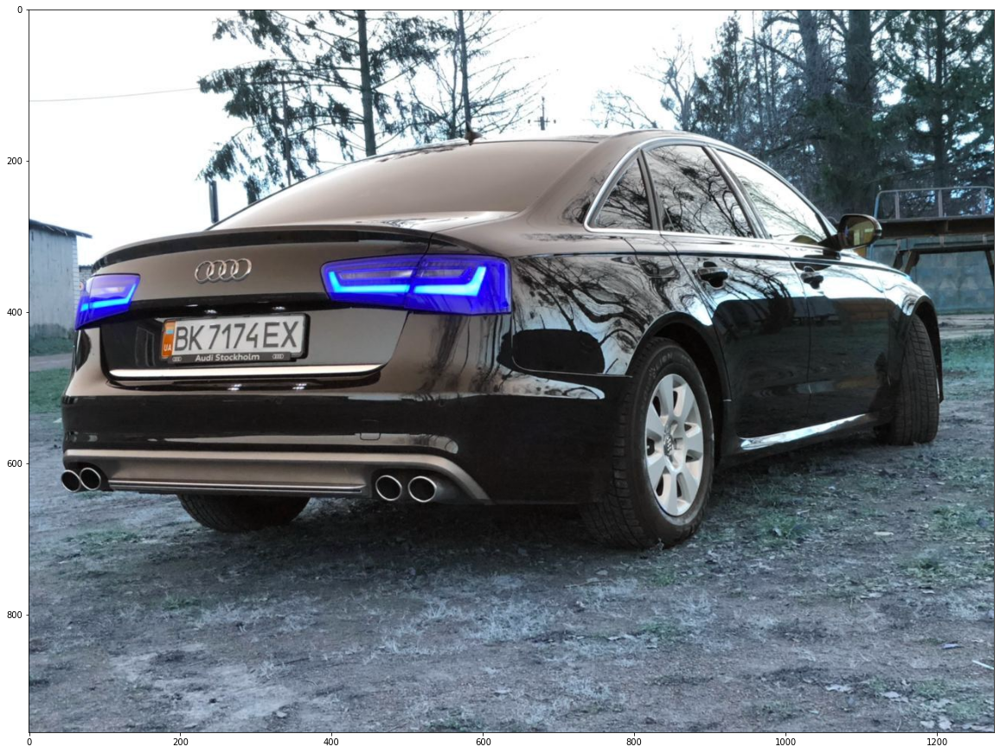

fake /mnt/raid/var/www/nomeroff-net/nomeroff_net/tools/../../data/./dataset/Detector/yolov5/autoriaNumberplateDataset-2021-12-12/train/369351703-28729425.jpeg [(250, 807), (252, 860), (48, 810), (40, 758)]


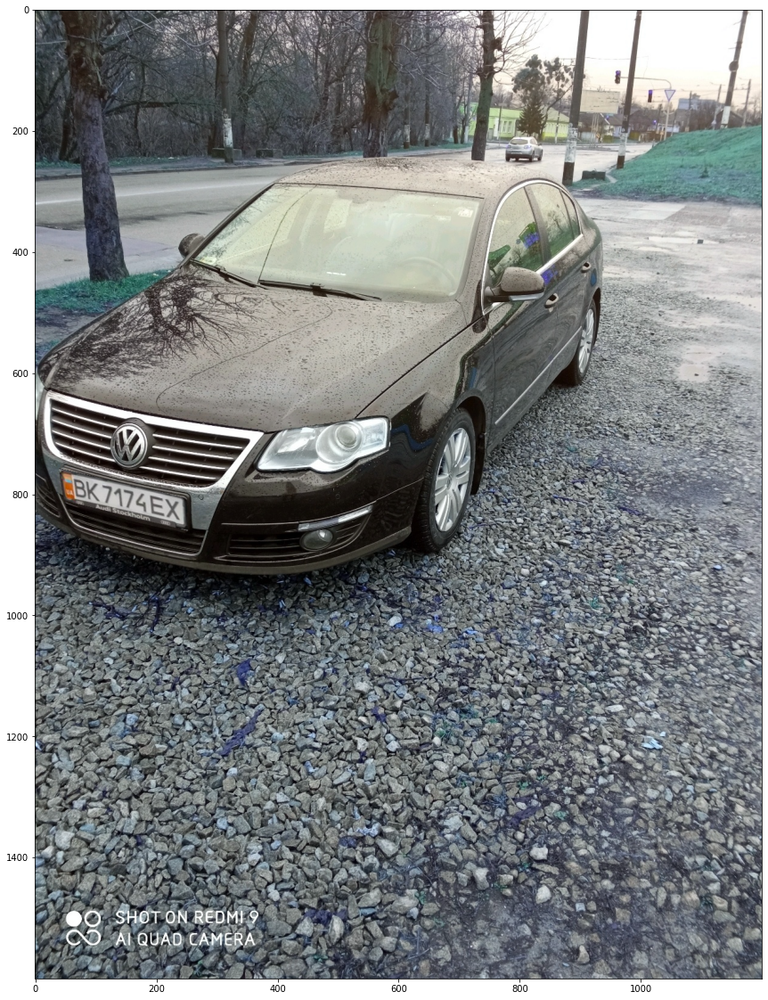

fake /mnt/raid/var/www/nomeroff-net/nomeroff_net/tools/../../data/./dataset/Detector/yolov5/autoriaNumberplateDataset-2021-12-12/train/369376618-28731000.jpeg [(946, 736), (949, 833), (535, 840), (530, 744)]


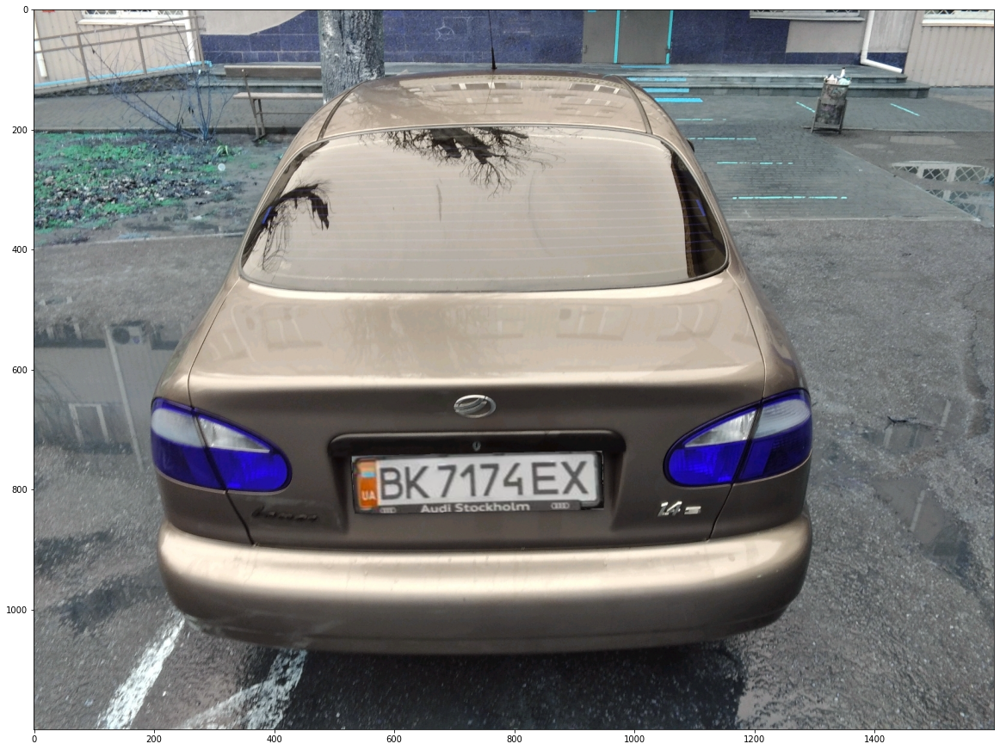

fake /mnt/raid/var/www/nomeroff-net/nomeroff_net/tools/../../data/./dataset/Detector/yolov5/autoriaNumberplateDataset-2021-12-12/train/369355213-28729404.jpeg [(218, 727), (219, 769), (130, 725), (129, 682)]


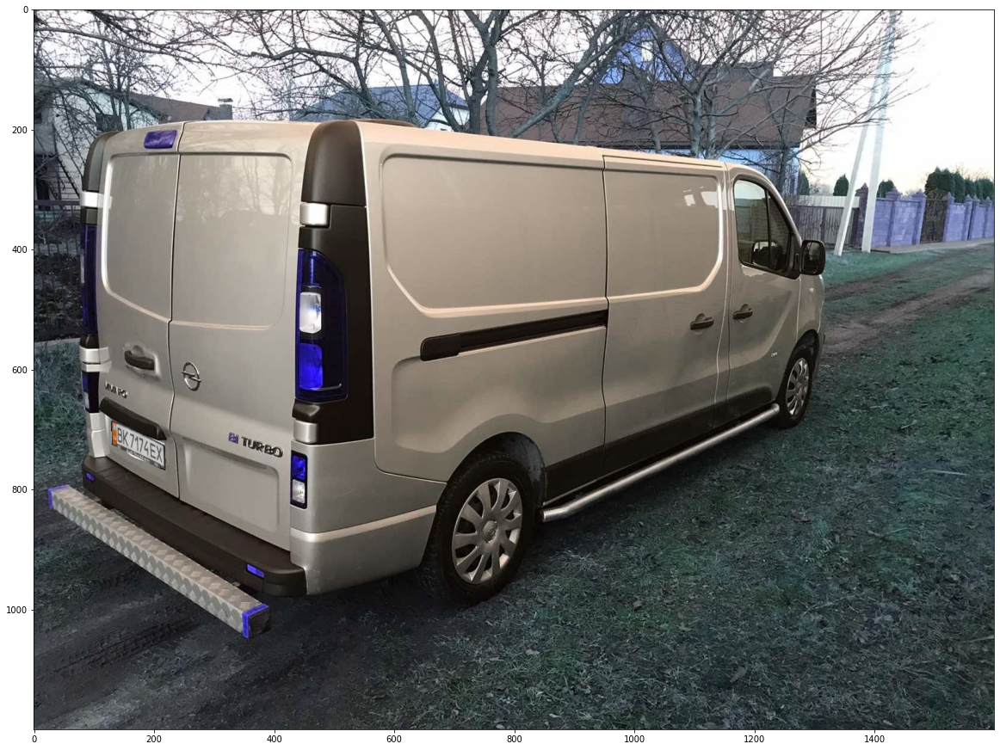

fake /mnt/raid/var/www/nomeroff-net/nomeroff_net/tools/../../data/./dataset/Detector/yolov5/autoriaNumberplateDataset-2021-12-12/train/380517365.jpeg [(204, 695), (325, 709), (340, 619), (218, 613)]


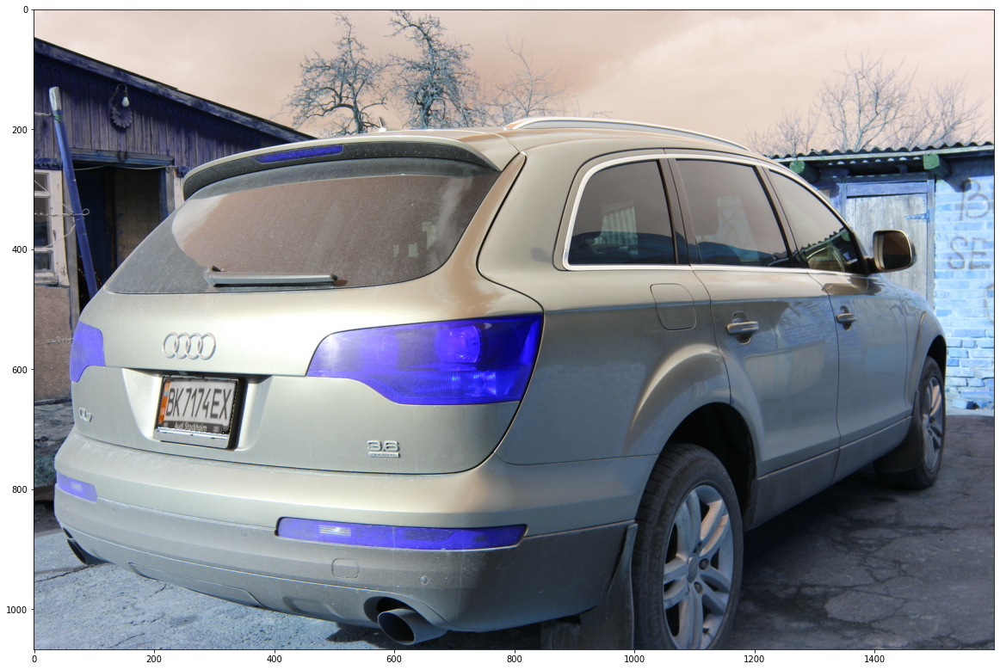

fake /mnt/raid/var/www/nomeroff-net/nomeroff_net/tools/../../data/./dataset/Detector/yolov5/autoriaNumberplateDataset-2021-12-12/train/Finland-Japanese-Car-Meet-Toyota-Corolla-E10.jpg [(159, 257), (163, 279), (220, 293), (217, 269)]


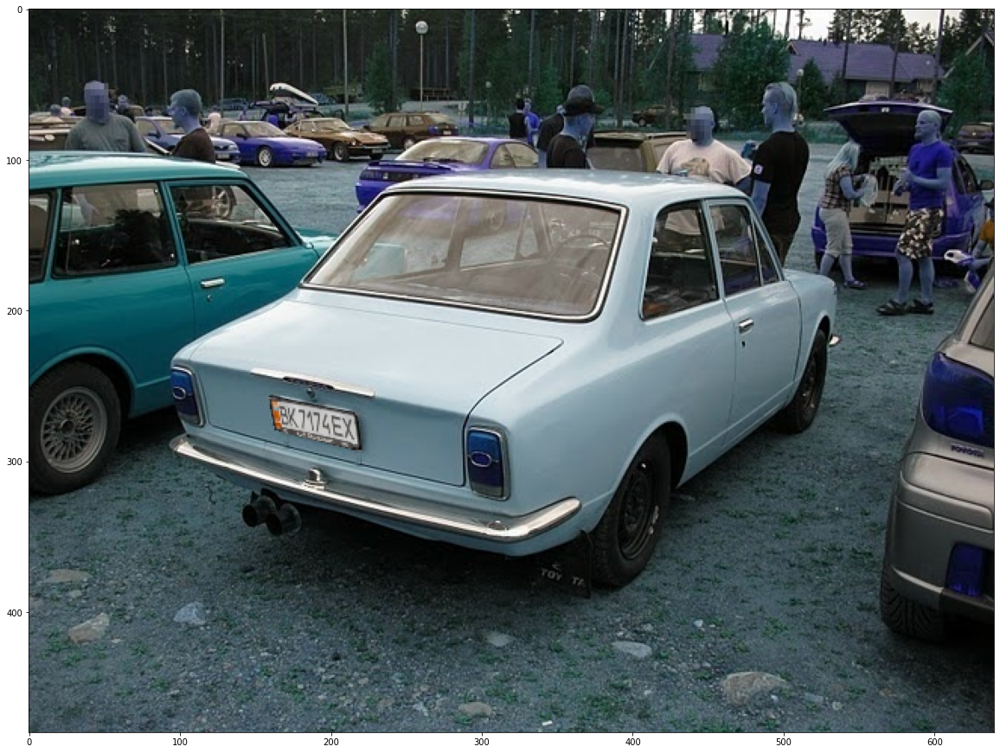

fake /mnt/raid/var/www/nomeroff-net/nomeroff_net/tools/../../data/./dataset/Detector/yolov5/autoriaNumberplateDataset-2021-12-12/train/369353642-28729310.jpeg [(604, 612), (957, 615), (954, 704), (608, 700)]


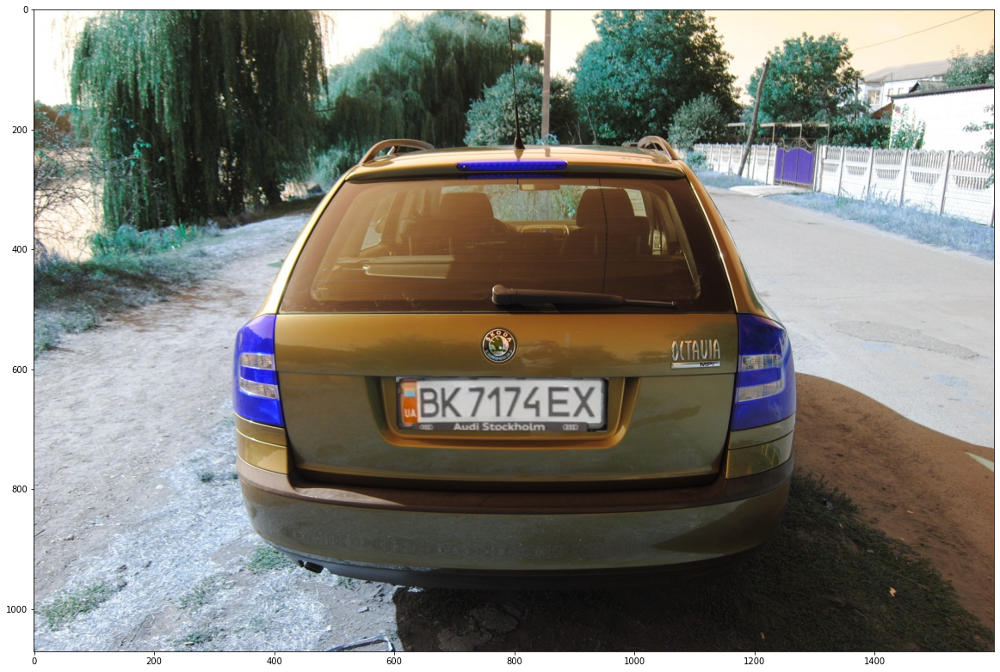

fake /mnt/raid/var/www/nomeroff-net/nomeroff_net/tools/../../data/./dataset/Detector/yolov5/autoriaNumberplateDataset-2021-12-12/train/248180709orig.jpeg [(139, 872), (141, 926), (28, 876), (26, 832)]


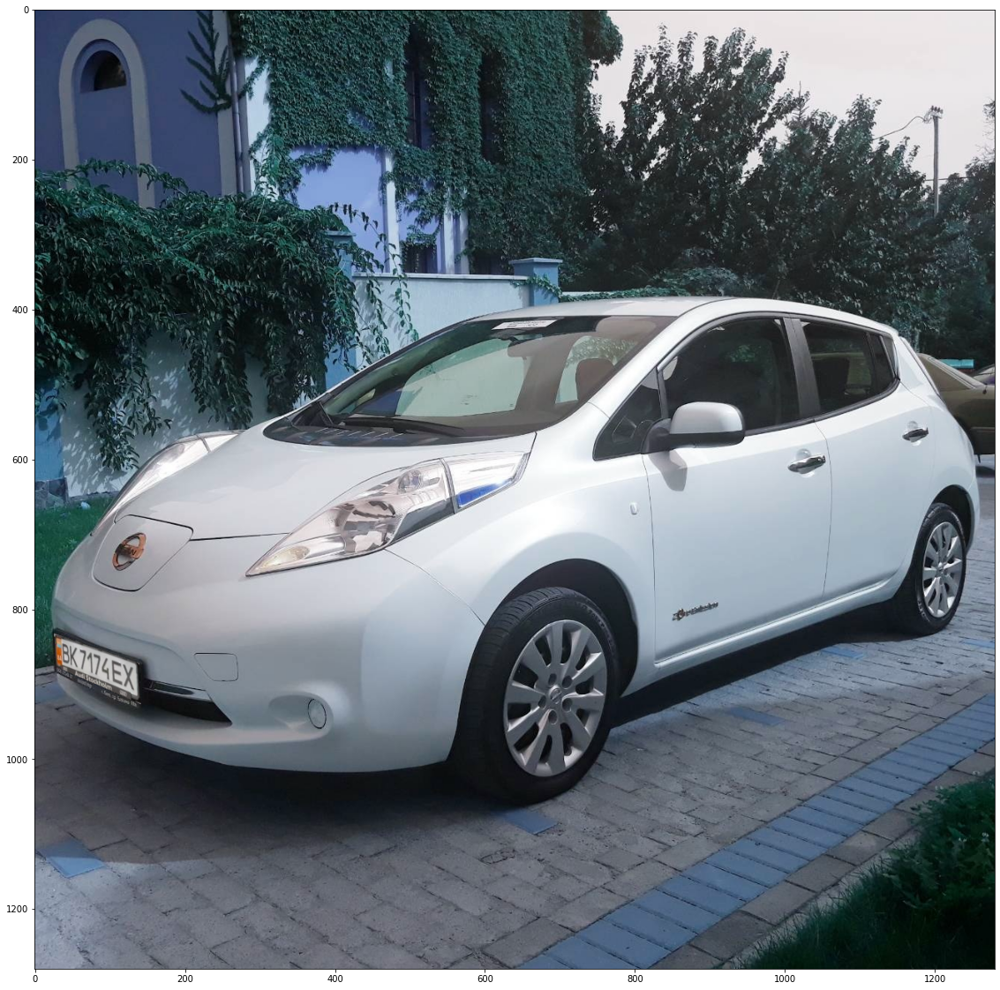

fake /mnt/raid/var/www/nomeroff-net/nomeroff_net/tools/../../data/./dataset/Detector/yolov5/autoriaNumberplateDataset-2021-12-12/train/369350037-28729186.jpeg [(136, 140), (136, 149), (176, 150), (176, 140)]


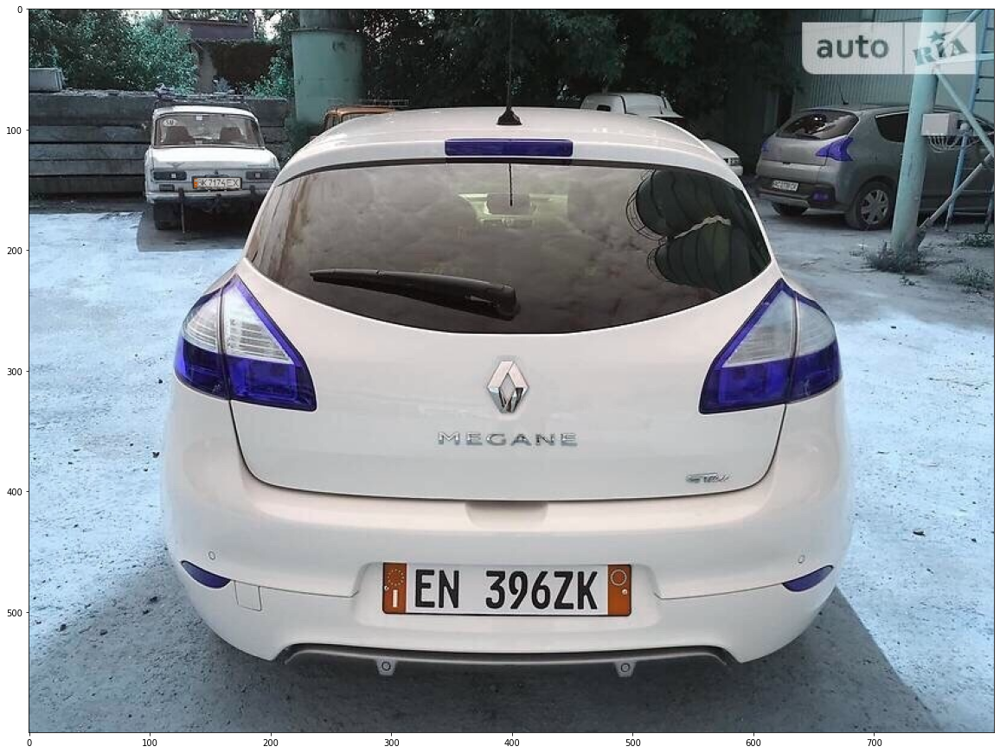

fake /mnt/raid/var/www/nomeroff-net/nomeroff_net/tools/../../data/./dataset/Detector/yolov5/autoriaNumberplateDataset-2021-12-12/train/380663181.jpeg [(216, 690), (289, 706), (289, 749), (218, 731)]


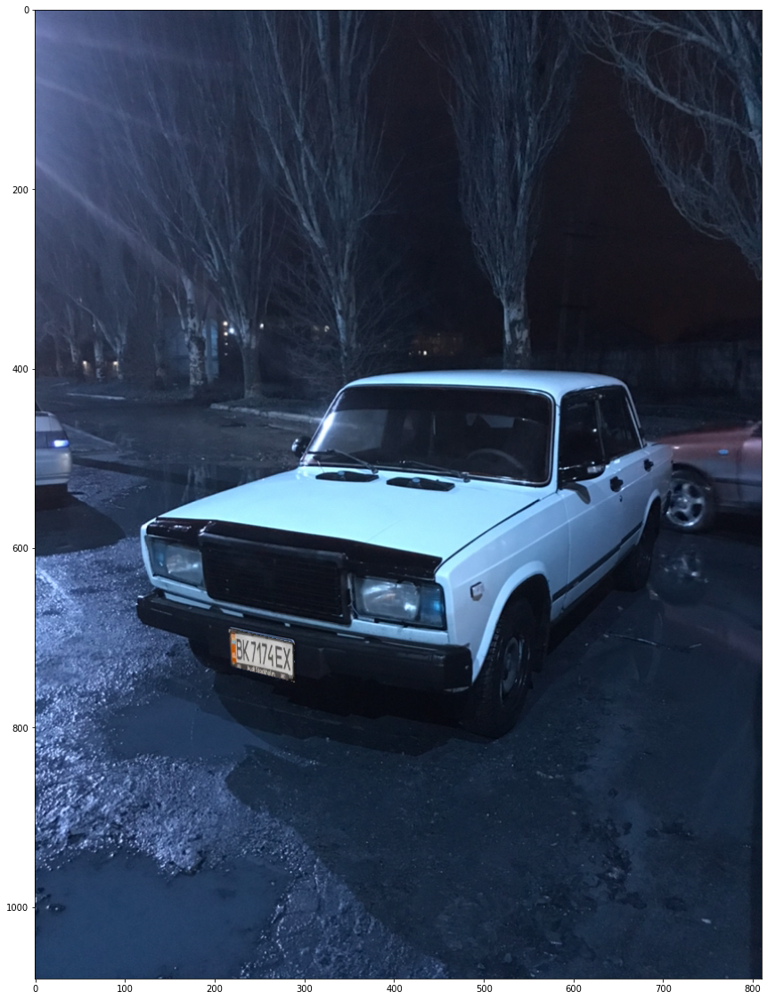

fake /mnt/raid/var/www/nomeroff-net/nomeroff_net/tools/../../data/./dataset/Detector/yolov5/autoriaNumberplateDataset-2021-12-12/train/369349379-28729096.jpeg [(1569, 647), (1569, 728), (1401, 773), (1400, 678)]


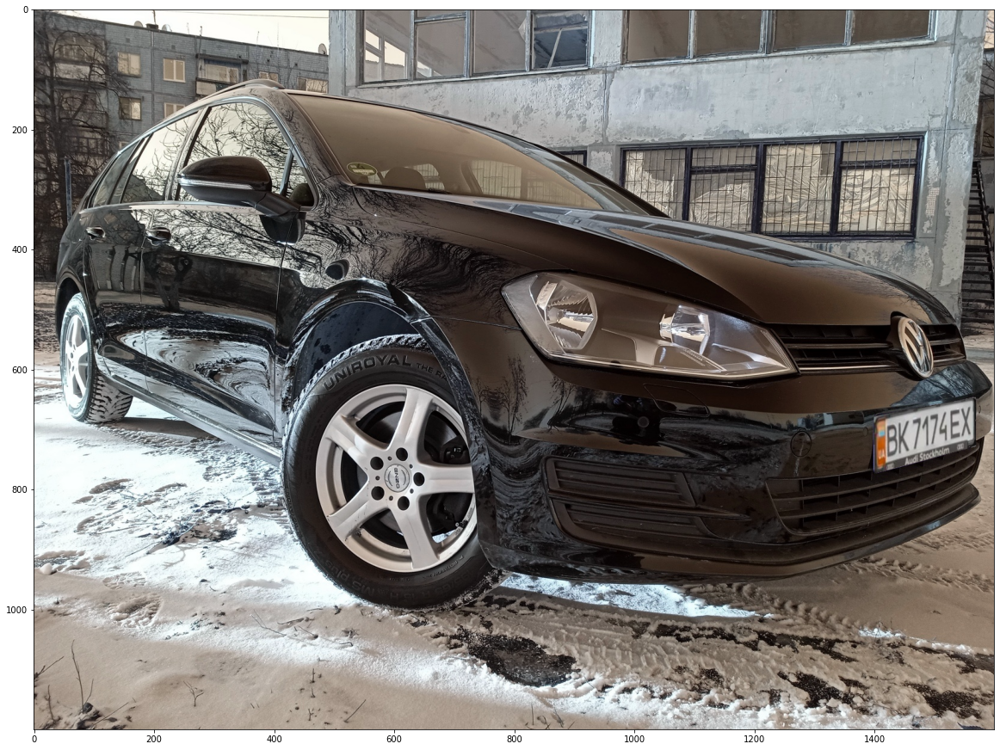

  0%|                                                                                                                                                                                                                | 0/8243 [00:08<?, ?it/s]


In [167]:
count_fake = 10
for dataset in DATASETS:
    n = len(res_datasets[dataset])
    print(dataset, n)
    for i, item in tqdm.tqdm(enumerate(res_datasets[dataset]), total=n):
        img_path, np_four_points = item
        print(img_path, np_four_points)
        img = cv2.imread(img_path)
        plt.imshow(img)
        plt.show()
        
        for fake_i in range(count_fake):
            random_i = i
            while random_i == i:
                random_i = random.randint(0, n)
            fake_img_path, fake_np_four_points = res_datasets[dataset][random_i]
            print("fake", fake_img_path, fake_np_four_points)
            
            fake_img = cv2.imread(fake_img_path)
            ordered_p_orig = order_points(np.array(np_four_points, dtype = "float32"))
            ordered_p_fake = order_points(np.array(fake_np_four_points, dtype = "float32"))
                                      
            M = cv2.getPerspectiveTransform(ordered_p_orig, 
                                            ordered_p_fake)
            warped = cv2.warpPerspective(img, M, (fake_img.shape[1], fake_img.shape[0]))
            cntrs = ordered_p_fake.reshape(1, ordered_p_fake.shape[0], ordered_p_fake.shape[1]).astype(np.int32)
            
            stencil = numpy.zeros(warped.shape).astype(warped.dtype)
            contours = cntrs
            cv2.fillPoly(stencil, contours, [255, 255, 255])
            np_mask = cv2.bitwise_and(warped, stencil)
            
            overlay_img1 = np.ones(fake_img.shape,np.uint8)*255
            rows,cols,channels = np_mask.shape
            overlay_img1[:, :] = np_mask
            img2gray = cv2.cvtColor(overlay_img1,cv2.COLOR_BGR2GRAY)
            ret, mask = cv2.threshold(img2gray,10,255,cv2.THRESH_BINARY)
            mask_inv = cv2.bitwise_not(mask)
            temp1 = cv2.bitwise_and(fake_img, fake_img, mask = mask_inv)
            temp2 = cv2.bitwise_and(overlay_img1, overlay_img1, mask = mask)
            fake_np_img = cv2.add(temp1,temp2)
            
            plt.imshow(fake_np_img)
            plt.show()

        break
    break

In [159]:
count_fake = 10
margin = 10
for dataset in DATASETS:
    n = len(res_datasets[dataset])
    os.makedirs(os.path.join(RES_DIR, dataset), exist_ok=True)
    for i, item in tqdm.tqdm(enumerate(res_datasets[dataset]), total=n):
        img_path, np_four_points = item
        ordered_p_orig = order_points(np.array(np_four_points, dtype = "float32"))
        img = cv2.imread(img_path)
        max_y, max_x = int(max(ordered_p_orig[:,1]))+margin, int(max(ordered_p_orig[:,0]))+margin
        min_y, min_x = int(min(ordered_p_orig[:,1]))-margin, int(min(ordered_p_orig[:,0]))-margin
        max_y = max_y if max_y < img.shape[0] else img.shape[0] - 1 
        max_x = max_x if max_x < img.shape[1] else img.shape[1] - 1 
        min_y = min_y if min_y > 0 else 0 
        min_x = min_x if min_x > 0 else 0 
        cv2.imwrite(os.path.join(RES_DIR, dataset, f"orig_{i}_0.png"), img[min_y:max_y, min_x:max_x])
        
        for fake_i in range(count_fake):
            random_i = i
            while random_i == i:
                random_i = random.randint(0, n-1)
            fake_img_path, fake_np_four_points = res_datasets[dataset][random_i]
            
            fake_img = cv2.imread(fake_img_path)
            ordered_p_fake = order_points(np.array(fake_np_four_points, dtype = "float32"))
                                      
            M = cv2.getPerspectiveTransform(ordered_p_orig, 
                                            ordered_p_fake)
            warped = cv2.warpPerspective(img, M, (fake_img.shape[1], fake_img.shape[0]))
            cntrs = ordered_p_fake.reshape(1, ordered_p_fake.shape[0], ordered_p_fake.shape[1]).astype(np.int32)
            
            stencil = numpy.zeros(warped.shape).astype(warped.dtype)
            contours = cntrs
            cv2.fillPoly(stencil, contours, [255, 255, 255])
            np_mask = cv2.bitwise_and(warped, stencil)
            
            overlay_img1 = np.ones(fake_img.shape,np.uint8)*255
            rows,cols,channels = np_mask.shape
            overlay_img1[:, :] = np_mask
            img2gray = cv2.cvtColor(overlay_img1,cv2.COLOR_BGR2GRAY)
            ret, mask = cv2.threshold(img2gray,10,255,cv2.THRESH_BINARY)
            mask_inv = cv2.bitwise_not(mask)
            temp1 = cv2.bitwise_and(fake_img, fake_img, mask = mask_inv)
            temp2 = cv2.bitwise_and(overlay_img1, overlay_img1, mask = mask)
            fake_np_img = cv2.add(temp1,temp2)
            
            max_y, max_x = int(max(ordered_p_fake[:,1]))+margin, int(max(ordered_p_fake[:,0]))+margin
            min_y, min_x = int(min(ordered_p_fake[:,1]))-margin, int(min(ordered_p_fake[:,0]))-margin
            
            max_y = max_y if max_y < fake_np_img.shape[0] else fake_np_img.shape[0] - 1 
            max_x = max_x if max_x < fake_np_img.shape[1] else fake_np_img.shape[1] - 1 
            min_y = min_y if min_y > 0 else 0 
            min_x = min_x if min_x > 0 else 0 
            cv2.imwrite(os.path.join(RES_DIR, dataset, f"fake_{i}_{fake_i}.png"), fake_np_img[min_y:max_y, min_x:max_x])

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 405/405 [03:42<00:00,  1.82it/s]
